In [ ]:
!pip install torchvision
!pip install torchinfo
!pip install -q git+https://github.com/huggingface/transformers.git
!pip install torchmetrics
!pip install nibabel

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
# ===== Phase 0: Setup & config =====
from google.colab import drive
drive.mount('/content/drive')

import os, random, bisect, time
import numpy as np
import nibabel as nib
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchinfo import summary
from transformers import AutoImageProcessor, Swinv2Model
from sklearn.model_selection import train_test_split
from torch.utils.data import WeightedRandomSampler
from scipy.ndimage import distance_transform_edt as edt
from scipy.ndimage import label as cc_label
import matplotlib.pyplot as plt

# Reproducibility
SEED = 42
random.seed(SEED); np.random.seed(SEED); torch.manual_seed(SEED); torch.cuda.manual_seed_all(SEED)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
AMP_DTYPE = torch.bfloat16 if (device.type=='cuda' and torch.cuda.is_bf16_supported()) else torch.float16

# Paths (edit)
ROOT = '/content/drive/MyDrive/CSC413data'
TASK = 'Task02_Heart'
images_dir = f'{ROOT}/{TASK}/{TASK}/imagesTr'
labels_dir = f'{ROOT}/{TASK}/{TASK}/labelsTr'
starts_with = 'la'  # optional filter

# Hparams
BATCH_SIZE = 8
EPOCHS = 100
LR = 1e-4  # safer start
DEBUG = True  # start with single-process DataLoader while debugging
NUM_WORKERS = 0 if DEBUG else min(8, os.cpu_count() or 4)
PIN_MEM = (device.type=='cuda') and not DEBUG


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# ===== Phase 1: Pair files, dataset, loaders =====

def pair_by_stem(img_dir, lbl_dir, starts_with=None):
    def stem(p):
        b = os.path.basename(p)
        return b.replace('.nii.gz','').replace('.nii','')
    imgs = [os.path.join(img_dir, f) for f in os.listdir(img_dir) if f.endswith(('.nii','.nii.gz'))]
    lbls = [os.path.join(lbl_dir, f) for f in os.listdir(lbl_dir) if f.endswith(('.nii','.nii.gz'))]
    if starts_with:
        imgs = [p for p in imgs if os.path.basename(p).startswith(starts_with)]
        lbls = [p for p in lbls if os.path.basename(p).startswith(starts_with)]
    imap = {stem(p): p for p in imgs}
    lmap = {stem(p): p for p in lbls}
    keys = sorted(set(imap) & set(lmap))
    missing = sorted((set(imap) ^ set(lmap)))
    return [imap[k] for k in keys], [lmap[k] for k in keys], missing

image_files, label_files, missing = pair_by_stem(images_dir, labels_dir, starts_with)
print("Missing (if any):", missing[:5])

def make_3c(x):
    if not isinstance(x, torch.Tensor):
        x = torch.as_tensor(x)
    if x.ndim == 4:
        if x.shape[1] in (1,3): return x if x.shape[1]==3 else x.repeat(1,3,1,1)
        if x.shape[-1] in (1,3):
            x = x.permute(0,3,1,2); return x if x.shape[1]==3 else x.repeat(1,3,1,1)
    elif x.ndim == 3:
        if x.shape[0] in (1,3): return x if x.shape[0]==3 else x.repeat(3,1,1)
        if x.shape[-1] in (1,3):
            x = x.permute(2,0,1); return x if x.shape[0]==3 else x.repeat(3,1,1)
    raise ValueError(f"Unsupported tensor shape {tuple(x.shape)}")

class MedicalImageDataset(Dataset):
    def __init__(self, image_paths, label_paths, augment=True, normalize=True):
        assert len(image_paths) == len(label_paths)
        self.image_paths = list(image_paths)
        self.label_paths = list(label_paths)
        self.augment = augment
        self.normalize = normalize
        self.cache = {}
        self.index_map = []
        total = 0
        for p in self.image_paths:
            vol = nib.load(p).get_fdata(dtype=np.float32)
            if vol.ndim == 4 and vol.shape[-1] == 1: vol = vol[...,0]
            assert vol.ndim == 3, f"Expected 3D vol, got {vol.shape}"
            total += vol.shape[-1]
            self.index_map.append(total)
        self.length = total

    def __len__(self): return self.length

    def _load_case(self, case_idx):
        if case_idx in self.cache: return self.cache[case_idx]
        img = nib.load(self.image_paths[case_idx]).get_fdata(dtype=np.float32)
        lbl = nib.load(self.label_paths[case_idx]).get_fdata(dtype=np.float32)
        if img.ndim == 4 and img.shape[-1]==1: img = img[...,0]
        if lbl.ndim == 4 and lbl.shape[-1]==1: lbl = lbl[...,0]
        if img.shape != lbl.shape:
            raise ValueError(f"Shape mismatch {img.shape} vs {lbl.shape}\n  {self.image_paths[case_idx]}\n  {self.label_paths[case_idx]}")
        self.cache[case_idx] = (img, lbl)
        return img, lbl

    def _loc(self, global_idx):
        case_idx = bisect.bisect_right(self.index_map, global_idx)
        prev = self.index_map[case_idx-1] if case_idx>0 else 0
        return case_idx, global_idx - prev

    @staticmethod
    def _minmax(x: torch.Tensor, eps=1e-6):
        x = torch.nan_to_num(x, nan=0.0, posinf=0.0, neginf=0.0)
        mn, mx = torch.amin(x), torch.amax(x)
        return (x - mn) / (mx - mn + eps)

    def _augment(self, img2d, lbl2d):
        if np.random.rand() > 0.5:
            ax = np.random.choice([0,1])
            img2d = np.flip(img2d, axis=ax).copy()
            lbl2d = np.flip(lbl2d, axis=ax).copy()
        if np.random.rand() > 0.5:
            k = np.random.choice([1,2,3])
            img2d = np.rot90(img2d, k, axes=(0,1)).copy()
            lbl2d = np.rot90(lbl2d, k, axes=(0,1)).copy()
        return img2d, lbl2d

    def __getitem__(self, idx):
        try:
            case_idx, slice_idx = self._loc(idx)
            img_vol, lbl_vol   = self._load_case(case_idx)

            H, W, D = img_vol.shape
            s0 = max(0, slice_idx - 1)
            s1 = slice_idx
            s2 = min(D - 1, slice_idx + 1)

            ch0 = np.nan_to_num(img_vol[:, :, s0], nan=0.0, posinf=0.0, neginf=0.0)
            ch1 = np.nan_to_num(img_vol[:, :, s1], nan=0.0, posinf=0.0, neginf=0.0)
            ch2 = np.nan_to_num(img_vol[:, :, s2], nan=0.0, posinf=0.0, neginf=0.0)
            lbl2d = np.nan_to_num(lbl_vol[:, :, s1], nan=0.0, posinf=0.0, neginf=0.0)

            # stack to (3,H,W)
            img3 = np.stack([ch0, ch1, ch2], axis=0)

            # simple paired augments applied to both img and lbl
            if self.augment:
                if np.random.rand() > 0.5:
                    ax = np.random.choice([1, 2])  # 1->H, 2->W for (C,H,W)
                    img3 = np.flip(img3, axis=ax).copy()
                    lbl2d = np.flip(lbl2d, axis=ax-1).copy()
                if np.random.rand() > 0.5:
                    k = np.random.choice([1, 2, 3])
                    # rotate (C,H,W) around last two dims; label around (H,W)
                    img3 = np.rot90(img3, k, axes=(1, 2)).copy()
                    lbl2d = np.rot90(lbl2d, k, axes=(0, 1)).copy()

            img3 = torch.from_numpy(img3).float()                  # (3,H,W)
            if self.normalize:
                img3 = self._minmax(img3)
            lbl = torch.from_numpy((lbl2d > 0).astype(np.uint8)).float()  # (H,W)
            return img3, lbl
        except Exception as e:
            raise RuntimeError(f"Dataset error at idx={idx}, case/slice={self._loc(idx)}: {e}")


def split_dataset(image_files, label_files, test_pct=0.2, val_pct=0.1, seed=SEED):
    tr_img, tv_img, tr_lbl, tv_lbl = train_test_split(image_files, label_files, test_size=test_pct+val_pct, random_state=seed, shuffle=True)
    val_frac = val_pct / (test_pct+val_pct) if (test_pct+val_pct)>0 else 0.0
    val_img, test_img, val_lbl, test_lbl = train_test_split(tv_img, tv_lbl, test_size=(1.0-val_frac), random_state=seed, shuffle=True)
    return {
        'train': MedicalImageDataset(tr_img,   tr_lbl,  augment=True),
        'val'  : MedicalImageDataset(val_img, val_lbl, augment=False),
        'test' : MedicalImageDataset(test_img, test_lbl,augment=False),
    }

def make_loader(ds, bs, shuffle, workers=NUM_WORKERS):
    return DataLoader(ds, batch_size=bs, shuffle=shuffle, num_workers=workers, pin_memory=PIN_MEM, persistent_workers=(workers>0))

datasets = split_dataset(image_files, label_files, test_pct=0.2, val_pct=0.1)
train_dataset, val_dataset, test_dataset = datasets['train'], datasets['val'], datasets['test']

def compute_fg_flags(ds):
    flags = []
    for idx in range(ds.length):
        case_idx, s = ds._loc(idx)
        _, lbl_vol = ds._load_case(case_idx)
        lbl2d = lbl_vol[:, :, s]
        flags.append(bool((lbl2d > 0).any()))
    return flags

# 1) Compute per-slice foreground flags (one-time)
pos_flags = compute_fg_flags(train_dataset)
n_pos = sum(pos_flags); n_all = len(pos_flags)
print(f"Train slices: {n_all} (pos={n_pos}, neg={n_all-n_pos})")

# 2) Choose weights (down-weight negatives)
w_pos, w_neg = 1.0, 0.5   # try 0.1–0.5 for w_neg; tune as needed
weights = torch.tensor([w_pos if f else w_neg for f in pos_flags], dtype=torch.float)

# 3) Build sampler
g = torch.Generator()
g.manual_seed(SEED)
sampler = WeightedRandomSampler(weights=weights,
                                num_samples=len(weights),
                                replacement=True,
                                generator=g)

train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    sampler=sampler,
    num_workers=NUM_WORKERS,
    pin_memory=PIN_MEM,
    persistent_workers=(NUM_WORKERS > 0)
)
val_loader   = make_loader(val_dataset,   min(2*BATCH_SIZE, 20), False)
test_loader  = make_loader(test_dataset,  min(2*BATCH_SIZE, 20), False)


Missing (if any): []
Train slices: 1491 (pos=893, neg=598)


In [ ]:
# ===== Phase 2: Backbone & differentiable preprocess (fine-tuning stage 3) =====

# 1) Load backbone once
backbone = Swinv2Model.from_pretrained(
    "microsoft/swinv2-large-patch4-window12-192-22k"
).to(device)

# (optional) quick summary on CPU
try:
    backbone_cpu = backbone.to("cpu")
    summary(backbone_cpu, input_size=(1, 3, 192, 192),
            col_names=['input_size','output_size','num_params','trainable'],
            device='cpu')
finally:
    backbone.to(device)

# 2) Grab mean/std for normalization (fast processor just to read config)
proc_cfg = AutoImageProcessor.from_pretrained(
    "microsoft/swinv2-large-patch4-window12-192-22k", use_fast=True
)
MEAN = torch.tensor(proc_cfg.image_mean).view(1, 3, 1, 1).to(device)
STD  = torch.tensor(proc_cfg.image_std).view(1, 3, 1, 1).to(device)

# 3) Differentiable preprocess (use this everywhere)
def preprocess_torch(batch_imgs: torch.Tensor, device: torch.device):
    """
    (B,3,H,W) in [0,1] -> 4 Swin stage token tensors (B, N_i, C_i).
    Keeps the graph so stage-3 can be fine-tuned.
    """
    x = F.interpolate(batch_imgs, size=(192, 192), mode='bilinear', align_corners=False)
    x = (x - MEAN.to(x.dtype)) / STD.to(x.dtype)

    outputs = backbone(pixel_values=x, output_hidden_states=True, return_dict=True)

    fmaps = getattr(outputs, "reshaped_hidden_states", None)
    if isinstance(fmaps, (list, tuple)) and len(fmaps) >= 4:
        return tuple(fm.flatten(2).transpose(1, 2).contiguous() for fm in fmaps[:4])

    # Fallback by token counts (48*48, 24*24, 12*12, 6*6 for 192x192, patch=4)
    hs = outputs.hidden_states
    H = W = 192
    patch = getattr(getattr(backbone, 'config', object()), 'patch_size', 4)
    n0 = (H // patch) * (W // patch)  # 2304
    targets = [n0, n0 // 4, n0 // 16, n0 // 64]  # 2304, 576, 144, 36
    picked = []
    for N in targets:
        cand = None
        for t in hs:
            if t.ndim == 3 and t.shape[1] == N:
                cand = t
        if cand is None:
            raise RuntimeError(f"No hidden_state with {N} tokens.")
        picked.append(cand.contiguous())
    return tuple(picked)

# 4) Unfreeze only the last Swin stage and set train mode
for name, p in backbone.named_parameters():
    p.requires_grad = ('stages.3' in name)
backbone.train()

# 5) (optional) Save memory
try:
    backbone.gradient_checkpointing_enable()
except Exception:
    pass  # not all versions support it


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


In [ ]:
# ===== Phase 3: Decoder =====

def Norm2d(ch, kind='gn', groups=32):
    if kind == 'gn':
        # pick a valid divisor of ch, prefer <= groups
        for g in [groups, 16, 8, 4, 2, 1]:
            if ch % g == 0:
                return nn.GroupNorm(num_groups=g, num_channels=ch, eps=1e-5, affine=True)
        # fallback: 1 group always divides
        return nn.GroupNorm(num_groups=1, num_channels=ch, eps=1e-5, affine=True)
    return nn.BatchNorm2d(ch)


class SelfAttention(nn.Module):
    def __init__(self, in_channels, attn_ratio=8, attn_dropout=0.0):
        super().__init__()
        d = max(1, in_channels // attn_ratio)
        self.q = nn.Conv2d(in_channels, d, 1, bias=True)
        self.k = nn.Conv2d(in_channels, d, 1, bias=True)
        self.v = nn.Conv2d(in_channels, in_channels, 1, bias=True)
        self.register_buffer("scale", torch.tensor(d ** -0.5, dtype=torch.float32), persistent=False)
        self.drop = nn.Dropout(attn_dropout) if attn_dropout>0 else nn.Identity()

    def forward(self, x):
        B,C,H,W = x.shape
        q = self.q(x).flatten(2).transpose(1,2)  # (B,HW,d)
        k = self.k(x).flatten(2).transpose(1,2)  # (B,HW,d)
        v = self.v(x).flatten(2).transpose(1,2)  # (B,HW,C)
        # FP32-safe attention math
        q32, k32, v32 = q.float(), k.float(), v.float()
        scores = torch.bmm(q32, k32.transpose(1,2)) * float(self.scale)
        scores = scores - scores.amax(dim=-1, keepdim=True)
        attn = F.softmax(scores, dim=-1)
        attn = self.drop(attn)
        out = torch.bmm(attn, v32).transpose(1,2).contiguous().view(B,C,H,W)
        return out.to(x.dtype)

class ChannelAttention(nn.Module):
    def __init__(self, in_ch, ratio=16, norm='gn'):
        super().__init__()
        hid = max(1, in_ch//ratio)
        self.mlp = nn.Sequential(
            nn.Conv2d(in_ch, hid, 1, bias=True),
            nn.ReLU(inplace=True),
            nn.Conv2d(hid, in_ch, 1, bias=True),
        )
        self.avg = nn.AdaptiveAvgPool2d(1)
        self.max = nn.AdaptiveMaxPool2d(1)
        self.act = nn.Sigmoid()
    def forward(self, x):
        return x * self.act(self.mlp(self.avg(x)) + self.mlp(self.max(x)))

class SAWrapper(nn.Module):
    def __init__(self, ch, attn_ratio=8, attn_p=0.0, norm='gn'):
        super().__init__()
        self.norm = Norm2d(ch, kind=norm)
        self.sa = SelfAttention(ch, attn_ratio=attn_ratio, attn_dropout=attn_p)
    def forward(self, x):
        return x + self.sa(self.norm(x))

class UpBlock(nn.Module):
    def __init__(self, in_cur, in_skip, out_ch, use_ca=True, r=2, norm='gn'):
        super().__init__()
        self.cur_up = nn.Sequential(
            nn.Conv2d(in_cur, (r*r)*out_ch, 3, padding=1, bias=False),
            Norm2d((r*r)*out_ch, kind=norm),
            nn.ReLU(inplace=True),
            nn.PixelShuffle(r),
        )
        in_total = out_ch + in_skip
        self.ca = ChannelAttention(in_total) if use_ca else nn.Identity()
        self.fuse = nn.Sequential(
            nn.Conv2d(in_total, out_ch, 3, padding=1, bias=False),
            Norm2d(out_ch, kind=norm), nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1, bias=False),
            Norm2d(out_ch, kind=norm), nn.ReLU(inplace=True),
        )
    def forward(self, x_cur, x_skip):
        up = self.cur_up(x_cur)           # upsampled to skip size
        x  = torch.cat([up, x_skip], 1)
        x  = self.ca(x)
        return self.fuse(x) + up          # residual

class UpBlockWithInlineSA(UpBlock):
    def __init__(self, in_cur, in_skip, out_ch, use_ca=True, r=2, attn_ratio=8, attn_p=0.0, norm='gn'):
        super().__init__(in_cur, in_skip, out_ch, use_ca=use_ca, r=r, norm=norm)
        self.sa = SAWrapper(out_ch, attn_ratio=attn_ratio, attn_p=attn_p, norm=norm)
    def forward(self, x_cur, x_skip):
        up = self.cur_up(x_cur)
        up = self.sa(up)
        x  = torch.cat([up, x_skip], 1)
        x  = self.ca(x)
        return self.fuse(x) + up

def _seq_to_bchw(x_seq, h, w):
    x = x_seq.permute(0,2,1).contiguous()
    B,C,N = x.shape; assert N == h*w
    return x.view(B,C,h,w)

def _hw_from_N(x_seq):
    N = x_seq.shape[1]
    h = w = int(float(N)**0.5)
    assert h*w == N
    return h,w

# ===== B) Model patch: add a learnable ×4 tail to output 192×192 logits =====
# Assumes you already have Norm2d, UpBlock, UpBlockWithInlineSA, etc.

class MRI_Seg_4in(nn.Module):
    """Takes four Swin stage tokens (B,N_i,C_i). Returns logits at 192×192 (no sigmoid)."""
    def __init__(self, ch_x0=None, ch_x1=None, ch_x2=None, ch_x3=None,
                 out_ch=1, use_sa=('up2','up1'), attn_ratio=8, attn_p=0.1, norm='gn'):
        super().__init__()
        self.out_ch = out_ch                            # <- store once
        self._infer = any(v is None for v in [ch_x0, ch_x1, ch_x2, ch_x3])
        self.use_sa = set(use_sa)
        self.attn_ratio, self.attn_p, self.norm = attn_ratio, attn_p, norm
        if not self._infer:
            self._build(ch_x0, ch_x1, ch_x2, ch_x3, self.out_ch)

    def _build(self, c0, c1, c2, c3, out_ch):
        self.up2 = (UpBlockWithInlineSA(c3, c2, 768, attn_ratio=self.attn_ratio, attn_p=self.attn_p, norm=self.norm)
                    if 'up2' in self.use_sa else UpBlock(c3, c2, 768, norm=self.norm))
        self.up1 = (UpBlockWithInlineSA(768, c1, 384, attn_ratio=self.attn_ratio, attn_p=self.attn_p, norm=self.norm)
                    if 'up1' in self.use_sa else UpBlock(768, c1, 384, norm=self.norm))
        self.up0 = UpBlock(384, c0, 192, norm=self.norm)

        # head keeps 48×48, tail learns 4× upsampling to 192×192 logits
        self.head = nn.Sequential(
            nn.Conv2d(192, 192, 3, padding=1, bias=False),
            Norm2d(192, kind=self.norm), nn.ReLU(inplace=True),
        )
        self.tail = nn.Sequential(
            nn.Conv2d(192, out_ch * 16, kernel_size=1, bias=True),  # 16 = 4×4 for PixelShuffle
            nn.PixelShuffle(4),  # -> (B, out_ch, 192, 192)
        )

    @torch.no_grad()
    def _lazy_init(self, X0_c, X1_c, X2_c, X3_c, device, dtype):
        self._build(X0_c, X1_c, X2_c, X3_c, self.out_ch)
        self.to(device=device, dtype=dtype)

    def forward(self, x0, x1, x2, x3):
        dev, dt = x0.device, x0.dtype
        # tokens -> feature maps
        def _seq_to_bchw(x_seq):
            N = x_seq.shape[1]
            h = w = int(float(N) ** 0.5)
            x = x_seq.permute(0,2,1).contiguous().view(x_seq.size(0), x_seq.size(2), h, w)
            return x
        X0, X1, X2, X3 = map(_seq_to_bchw, (x0, x1, x2, x3))  # 48×48, 24×24, 12×12, 6×6

        if self._infer and not hasattr(self, 'up2'):
            self._lazy_init(X0.shape[1], X1.shape[1], X2.shape[1], X3.shape[1], dev, dt)

        Y = self.up2(X3, X2)   # 6→12
        Y = self.up1(Y,  X1)   # 12→24
        Y = self.up0(Y,  X0)   # 24→48
        Y = self.head(Y)       # 48×48, 192ch
        logits = self.tail(Y)  # 192×192, out_ch
        return logits



In [ ]:
# ===== Phase 4: Losses & metrics =====


# ---------- EMA helper ----------
class EMA:
    def __init__(self, model: torch.nn.Module, decay: float = 0.999):
        self.decay = decay
        self.shadow = {
            n: p.detach().clone()
            for n, p in model.named_parameters()
            if p.requires_grad and p.dtype.is_floating_point
        }
        self.backup = None

    @torch.no_grad()
    def update(self, model: torch.nn.Module):
        d = self.decay
        for n, p in model.named_parameters():
            if n in self.shadow and p.requires_grad and p.dtype.is_floating_point:
                self.shadow[n].mul_(d).add_(p.detach(), alpha=1.0 - d)

    @torch.no_grad()
    def apply_to(self, model: torch.nn.Module):
        # swap in EMA params (save current to backup)
        self.backup = {}
        for n, p in model.named_parameters():
            if n in self.shadow and p.dtype.is_floating_point:
                self.backup[n] = p.detach().clone()
                p.data.copy_(self.shadow[n].data)

    @torch.no_grad()
    def restore(self, model: torch.nn.Module):
        # restore original params
        if self.backup is None: return
        for n, p in model.named_parameters():
            if n in self.backup and p.dtype.is_floating_point:
                p.data.copy_(self.backup[n].data)
        self.backup = None

# ---------- TTA & LCC helpers ----------
@torch.no_grad()
def tta_logits(model, imgs, device):
    """
    4-way flip TTA at LOGIT level. imgs: (B,3,H,W) in [0,1]
    """
    def _forward(x):
        x0,x1,x2,x3 = preprocess_torch(x, device)
        return model(x0,x1,x2,x3)

    outs = []
    outs.append(_forward(imgs))                                 # identity
    x = torch.flip(imgs, dims=[-1]); outs.append(torch.flip(_forward(x), dims=[-1])) # h
    x = torch.flip(imgs, dims=[-2]); outs.append(torch.flip(_forward(x), dims=[-2])) # v
    x = torch.flip(torch.flip(imgs, dims=[-2]), dims=[-1])      # hv
    outs.append(torch.flip(torch.flip(_forward(x), dims=[-2]), dims=[-1]))
    return torch.mean(torch.stack(outs, dim=0), dim=0)

@torch.no_grad()
def keep_largest_cc_batch(bin_mask: torch.Tensor) -> torch.Tensor:
    """
    Keep largest connected component per sample. bin_mask: (B,1,H,W) float/bool {0,1}
    """
    dev, dtype = bin_mask.device, bin_mask.dtype
    m = (bin_mask > 0.5).to(torch.uint8).detach().cpu().numpy()
    for i in range(m.shape[0]):
        lbl, n = cc_label(m[i, 0])
        if n <= 1: continue
        sizes = np.bincount(lbl.ravel())[1:]
        if sizes.size == 0: continue
        keep = 1 + int(sizes.argmax())
        m[i, 0] = (lbl == keep).astype(np.uint8)
    return torch.from_numpy(m).to(dev).to(dtype)



# 1) Dice+BCE (Dice-heavy)
class DiceLossFromLogits(nn.Module):
    def __init__(self, eps=1e-6): super().__init__(); self.eps=eps
    def forward(self, logits, target):
        p = torch.sigmoid(logits)
        B = p.size(0)
        p = p.view(B,-1); y = target.view(B,-1)
        inter = (p*y).sum(1); union = p.sum(1)+y.sum(1)
        dice = (2*inter + self.eps) / (union + self.eps)
        return 1.0 - dice.mean()

# This is probably a better loss, but for now we stick to the DiceLoss
class DiceBCELoss(nn.Module):
    def __init__(self, dw=2.0, bw=0.5):
        super().__init__()
        self.dice = DiceLossFromLogits()
        self.bce  = nn.BCEWithLogitsLoss()
        self.dw, self.bw = dw, bw
    def forward(self, logits, target):
        return self.dw*self.dice(logits, target) + self.bw*self.bce(logits, target)

# 2) Lightweight boundary loss (SDF target; no grads through SDF)
class BoundaryLoss(nn.Module):
    def __init__(self): super().__init__()
    def forward(self, logits, target):
        # logits: (B,1,H,W), target: (B,1,H,W) {0,1}
        with torch.no_grad():
            y = (target > 0.5).float().cpu().numpy().astype(np.uint8)
            sdf_list = []
            for i in range(y.shape[0]):
                g = y[i, 0]
                pos = edt(g)      # inside
                neg = edt(1 - g)  # outside
                sdf = (pos - neg) # signed
                # normalize to [-1,1] per-sample to stabilize the scale
                m = max(1e-6, np.max(np.abs(sdf)))
                sdf_list.append((sdf / m)[None, None, ...])
            sdf = torch.from_numpy(np.concatenate(sdf_list, axis=0)).to(logits.device)
        p = torch.sigmoid(logits)
        # encourage p≈1 inside (sdf>0), p≈0 outside (sdf<0), weight by |sdf|
        w = sdf.abs()
        inside = (sdf > 0).float()
        return F.l1_loss(p, inside, reduction='none').mul(w).mean()

@torch.no_grad()
def dice_metrics(model,
                 dataset,
                 device,
                 batch_size=16,
                 thr=0.5,
                 use_tta=True,
                 use_lcc=True):
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=False, num_workers=0)

    was_model, was_backb = model.training, backbone.training
    model.eval(); backbone.eval()

    soft_all, hard_all, soft_pos, hard_pos = [], [], [], []

    for imgs, labels in loader:
        imgs = make_3c(imgs).to(device).float()           # (B,3,H,W)
        labels = labels.to(device).unsqueeze(1).float()   # (B,1,H,W)

        # forward pass with optional TTA
        logits = tta_logits(model, imgs, device) if use_tta else model(*preprocess_torch(imgs, device))

        # resize preds to label size
        if logits.shape[-2:] != labels.shape[-2:]:
            logits = F.interpolate(logits, size=labels.shape[-2:], mode='bilinear', align_corners=False)

        probs = torch.sigmoid(logits)
        B = probs.size(0)
        p = probs.view(B, -1); y = labels.view(B, -1)

        # soft dice
        inter = (p*y).sum(1); union = p.sum(1) + y.sum(1)
        soft = (2*inter + 1e-6) / (union + 1e-6)
        soft_all += soft.tolist()

        # hard dice (+ optional LCC)
        pb = (probs > thr).float()
        if use_lcc: pb = keep_largest_cc_batch(pb)
        pbf = pb.view(B, -1)
        inter_b = (pbf*y).sum(1); union_b = pbf.sum(1) + y.sum(1)
        hard = (2*inter_b + 1e-6) / (union_b + 1e-6)
        hard_all += hard.tolist()

        # positive-only
        pos_mask = (y.sum(1) > 0)
        if pos_mask.any():
            soft_pos += soft[pos_mask].tolist()
            hard_pos += hard[pos_mask].tolist()

    if was_model: model.train()
    if was_backb: backbone.train()

    return {
        "soft_all": float(np.mean(soft_all)) if soft_all else float("nan"),
        "hard_all": float(np.mean(hard_all)) if hard_all else float("nan"),
        "soft_pos": float(np.mean(soft_pos)) if soft_pos else float("nan"),
        "hard_pos": float(np.mean(hard_pos)) if hard_pos else float("nan"),
    }

@torch.no_grad()
def get_dice_score(model, data, device=device, batch_size=16, threshold=0.5,
                   use_tta=True, use_lcc=True):
    m = dice_metrics(model, data, device=device, batch_size=batch_size, thr=threshold,
                     use_tta=use_tta, use_lcc=use_lcc)
    return {"soft_dice": m["soft_all"], "hard_dice": m["hard_all"]}


In [ ]:
def train_model_ft(net,
                   train_loader,
                   val_dataset,
                   epochs=50,
                   lr_dec=1e-4,
                   lr_enc=5e-5,
                   lambda_boundary=0.1,
                   thr=0.5,
                   use_tta_val=False,
                   use_lcc_val=False,
                   use_ema_val=True,
                   print_lr=True):
    net.to(device).train()
    backbone.to(device).train()

    # param groups
    dec_params = list(net.parameters())
    enc_params = [p for p in backbone.parameters() if p.requires_grad]
    optimizer = torch.optim.AdamW([
        {'params': dec_params, 'lr': lr_dec},
        {'params': enc_params, 'lr': lr_enc}
    ], weight_decay=1e-4)

    sched = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='max', factor=0.5, patience=3, verbose=True, min_lr=1e-6
    )

    scaler = torch.amp.GradScaler('cuda', enabled=(device.type=='cuda'))
    # criterion_main = DiceBCELoss(dw=2.0, bw=0.5)
    criterion_main = DiceLossFromLogits()
    # criterion_bd   = BoundaryLoss()

    # --- EMA trackers ---
    ema_net = EMA(net, decay=0.999)
    ema_backbone = EMA(backbone, decay=0.999)

    best_soft_pos = -1.0
    no_improve = 0

    for e in range(epochs):
        net.train(); backbone.train()
        total, steps = 0.0, 0

        for imgs, labels in train_loader:
            imgs = make_3c(imgs).to(device).float()
            labels = labels.to(device).unsqueeze(1).float()

            optimizer.zero_grad(set_to_none=True)
            with torch.amp.autocast('cuda',
                                     dtype=(torch.bfloat16 if (device.type=='cuda' and torch.cuda.is_bf16_supported()) else torch.float16),
                                     enabled=(device.type=='cuda')):
                x0,x1,x2,x3 = preprocess_torch(imgs, device)
                logits = net(x0,x1,x2,x3)
                if logits.shape[-2:] != labels.shape[-2:]:
                    logits = F.interpolate(logits, size=labels.shape[-2:], mode='bilinear', align_corners=False)
                # loss = criterion_main(logits, labels) + lambda_boundary * criterion_bd(logits, labels)
                loss = criterion_main(logits, labels)

            scaler.scale(loss).backward()
            scaler.unscale_(optimizer)
            torch.nn.utils.clip_grad_norm_(net.parameters(), 1.0)
            torch.nn.utils.clip_grad_norm_(enc_params, 1.0)
            scaler.step(optimizer); scaler.update()

            # EMA update AFTER step
            ema_net.update(net)
            ema_backbone.update(backbone)

            total += loss.item(); steps += 1

        avg_loss = total / max(1, steps)

        # ----- Validation (optionally using EMA weights) -----
        if use_ema_val:
            ema_net.apply_to(net); ema_backbone.apply_to(backbone)

        metrics = dice_metrics(
            net, val_dataset, device=device,
            batch_size=min(2*train_loader.batch_size, 20),
            thr=thr, use_tta=use_tta_val, use_lcc=use_lcc_val
        )

        if use_ema_val:
            ema_net.restore(net); ema_backbone.restore(backbone)

        sched.step(metrics["soft_pos"])

        if print_lr:
            lrs = [pg['lr'] for pg in optimizer.param_groups]
            print(f"LR(dec, enc): {lrs[0]:.2e}, {lrs[1]:.2e}")
        print(f"Epoch {e+1:02d}/{epochs:02d} | Loss {avg_loss:.4f} | "
              f"Val Dice soft_all={metrics['soft_all']:.4f} hard_all={metrics['hard_all']:.4f} "
              f"| soft_pos={metrics['soft_pos']:.4f} hard_pos={metrics['hard_pos']:.4f}")

        # Early stop / best save (store EMA snapshots too)
        improved = metrics["soft_pos"] > best_soft_pos + 1e-4
        if improved:
            best_soft_pos = metrics["soft_pos"]
            no_improve = 0

            # Save both raw and EMA states so you can pick later
            ckpt = {
                'model': net.state_dict(),
                'backbone': backbone.state_dict(),
                'ema_net': {k: v.clone().cpu() for k, v in ema_net.shadow.items()},
                'ema_backbone': {k: v.clone().cpu() for k, v in ema_backbone.shadow.items()},
                'metrics': metrics
            }
            torch.save(ckpt, '/content/best_mri_seg_ft.pt')
            print(f"  ✔ Saved checkpoint (soft_pos={best_soft_pos:.4f})")
        else:
            no_improve += 1
            # optional: early stop
            # if no_improve >= 6:
            #     print("Early stopping."); break


In [ ]:
# ===== Phase 6: Probes =====

def one_batch(ds, bs=2):
    return next(iter(DataLoader(ds, batch_size=bs, shuffle=False, num_workers=0)))

def nan_probe_no_workers(net):
    was_backb = backbone.training
    net.eval(); backbone.eval()
    imgs, _ = one_batch(train_dataset, bs=2)
    imgs = make_3c(imgs).to(device).float()
    with torch.inference_mode():
        assert torch.isfinite(imgs).all(), "NaNs in dataset images"
        x0,x1,x2,x3 = preprocess_torch(imgs, device)
        for i,t in enumerate((x0,x1,x2,x3)):
            assert torch.isfinite(t).all(), f"NaNs in tokens stage {i}"
        logits = net(x0,x1,x2,x3)
        assert torch.isfinite(logits).all(), "NaNs in logits"
        probs  = torch.sigmoid(logits)
        assert torch.isfinite(probs).all(), "NaNs in probs"
    if was_backb: backbone.train()
    print("Probe: all finite ✅")


def dataset_self_check(image_paths, label_paths, limit=None):
    problems=[]
    for idx,(ip,lp) in enumerate(zip(image_paths,label_paths)):
        if limit and idx>=limit: break
        try:
            img = nib.load(ip).get_fdata(dtype=np.float32)
            lbl = nib.load(lp).get_fdata(dtype=np.float32)
            if img.ndim==4 and img.shape[-1]==1: img=img[...,0]
            if lbl.ndim==4 and lbl.shape[-1]==1: lbl=lbl[...,0]
            if img.ndim!=3: problems.append((idx,ip,lp,f"img ndim {img.ndim} {img.shape}"))
            if lbl.ndim!=3: problems.append((idx,ip,lp,f"lbl ndim {lbl.ndim} {lbl.shape}"))
            if img.shape!=lbl.shape: problems.append((idx,ip,lp,f"shape mismatch {img.shape} vs {lbl.shape}"))
            if not np.isfinite(img).all(): problems.append((idx,ip,lp,"img has NaN/Inf"))
            if not np.isfinite(lbl).all(): problems.append((idx,ip,lp,"lbl has NaN/Inf"))
        except Exception as e:
            problems.append((idx,ip,lp,f"load_error: {e}"))
    return problems

def trace_first_nan(model, x0,x1,x2,x3):
    model.eval()
    handles=[]
    def mk(name):
        def hook(mod, inp, out):
            outs = out if isinstance(out,(tuple,list)) else (out,)
            for t in outs:
                if torch.is_tensor(t) and not torch.isfinite(t).all():
                    raise RuntimeError(f"NaNs after module: {name}, shape={tuple(t.shape)}")
        return hook
    for name, m in model.named_modules():
        if len(list(m.children()))==0:
            handles.append(m.register_forward_hook(mk(name)))
    try:
        _ = model(x0,x1,x2,x3)
    finally:
        for h in handles: h.remove()


In [ ]:
# ===== Phase 7: Instantiate, smoke test, train =====

# Synthetic Swin stage tokens for a smoke test (192×192 input)
x0 = torch.randn(1, 48*48, 192, device=device)
x1 = torch.randn(1, 24*24, 384, device=device)
x2 = torch.randn(1, 12*12, 768, device=device)
x3 = torch.randn(1,  6*6, 1536, device=device)

net = MRI_Seg_4in().to(device)
_ = net(x0,x1,x2,x3)  # builds lazily
print(summary(net, input_data=[x0,x1,x2,x3], device=device))

# Probe before training
nan_probe_no_workers(net)

# Train
train_model_ft(
    net,
    train_loader,
    val_dataset,
    epochs=50,
    lr_dec=1e-4,     # decoder LR
    lr_enc=5e-5,     # last Swin stage LR
    lambda_boundary=0.1,
    thr=0.5,
    use_tta_val=False,
    use_lcc_val=False,
    use_ema_val=True
)



Layer (type:depth-idx)                   Output Shape              Param #
MRI_Seg_4in                              [1, 1, 192, 192]          --
├─UpBlockWithInlineSA: 1-1               [1, 768, 12, 12]          --
│    └─Sequential: 2-1                   [1, 768, 12, 12]          --
│    │    └─Conv2d: 3-1                  [1, 3072, 6, 6]           42,467,328
│    │    └─GroupNorm: 3-2               [1, 3072, 6, 6]           6,144
│    │    └─ReLU: 3-3                    [1, 3072, 6, 6]           --
│    │    └─PixelShuffle: 3-4            [1, 768, 12, 12]          --
│    └─SAWrapper: 2-2                    [1, 768, 12, 12]          --
│    │    └─GroupNorm: 3-5               [1, 768, 12, 12]          1,536
│    │    └─SelfAttention: 3-6           [1, 768, 12, 12]          738,240
│    └─ChannelAttention: 2-3             [1, 1536, 12, 12]         --
│    │    └─AdaptiveAvgPool2d: 3-7       [1, 1536, 1, 1]           --
│    │    └─Sequential: 3-8              [1, 1536, 1, 1]          

/usr/local/lib/python3.11/dist-packages/torch/utils/checkpoint.py:87: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn(


LR(dec, enc): 1.00e-04, 5.00e-05
Epoch 01/50 | Loss 0.9221 | Val Dice soft_all=0.0184 hard_all=0.1320 | soft_pos=0.0268 hard_pos=0.1925
  ✔ Saved checkpoint (soft_pos=0.0268)
LR(dec, enc): 1.00e-04, 5.00e-05
Epoch 02/50 | Loss 0.6839 | Val Dice soft_all=0.0420 hard_all=0.2735 | soft_pos=0.0612 hard_pos=0.3988
  ✔ Saved checkpoint (soft_pos=0.0612)
LR(dec, enc): 1.00e-04, 5.00e-05
Epoch 03/50 | Loss 0.5035 | Val Dice soft_all=0.0839 hard_all=0.3369 | soft_pos=0.1224 hard_pos=0.4912
  ✔ Saved checkpoint (soft_pos=0.1224)
LR(dec, enc): 1.00e-04, 5.00e-05
Epoch 04/50 | Loss 0.4363 | Val Dice soft_all=0.1475 hard_all=0.3825 | soft_pos=0.2151 hard_pos=0.5509
  ✔ Saved checkpoint (soft_pos=0.2151)
LR(dec, enc): 1.00e-04, 5.00e-05
Epoch 05/50 | Loss 0.4125 | Val Dice soft_all=0.2237 hard_all=0.4274 | soft_pos=0.3263 hard_pos=0.5886
  ✔ Saved checkpoint (soft_pos=0.3263)
LR(dec, enc): 1.00e-04, 5.00e-05
Epoch 06/50 | Loss 0.4092 | Val Dice soft_all=0.2922 hard_all=0.4822 | soft_pos=0.4261 hard_

Val (EMA, TTA+LCC): {'soft_all': 0.43181102103917945, 'hard_all': 0.6088950607223801, 'soft_pos': 0.6297243143260308, 'hard_pos': 0.6310275101108854}
Test(EMA, TTA+LCC): {'soft_all': 0.4560470247739034, 'hard_all': 0.7402923505129412, 'soft_pos': 0.8278558868855117, 'hard_pos': 0.8247345013482643}


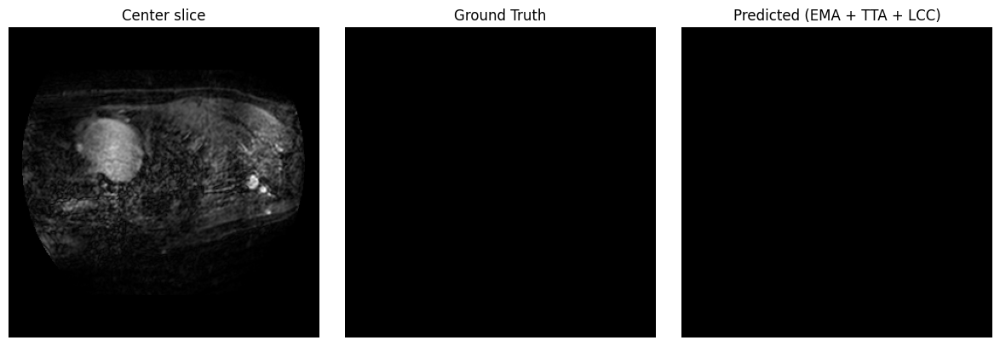

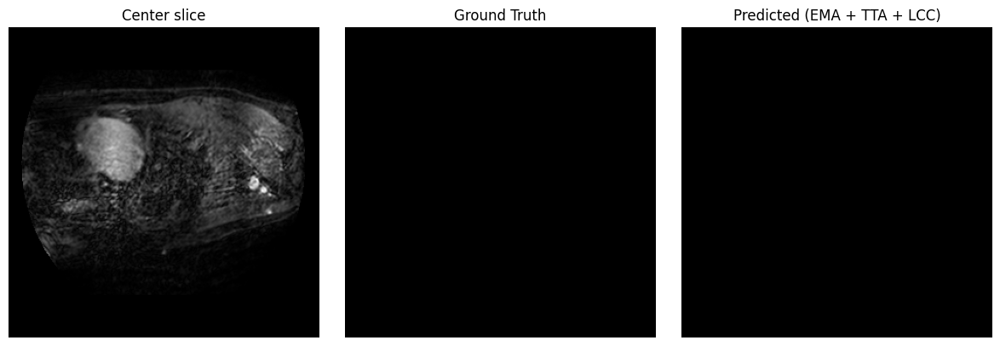

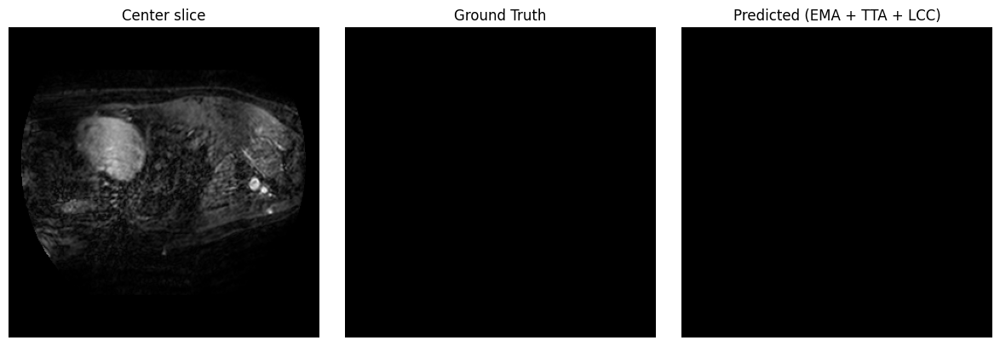

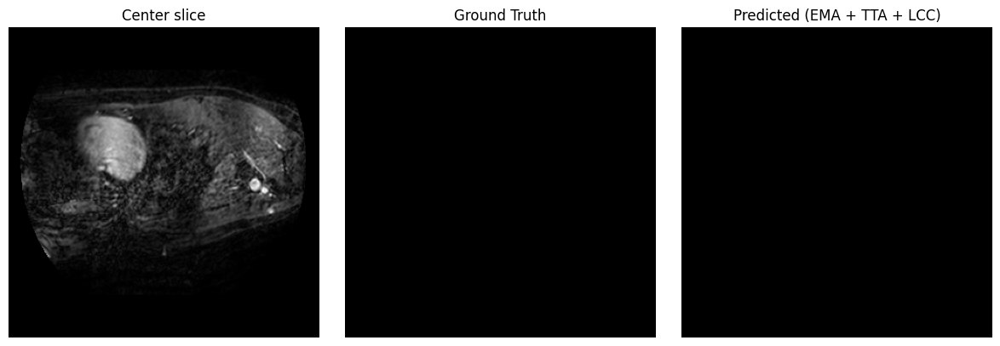

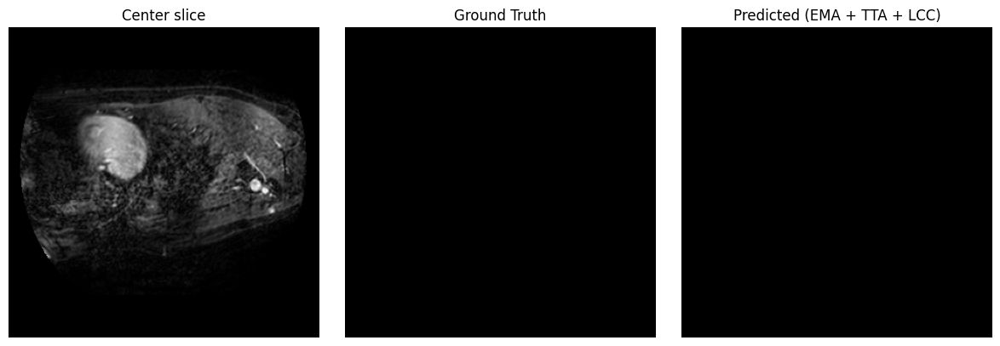

...

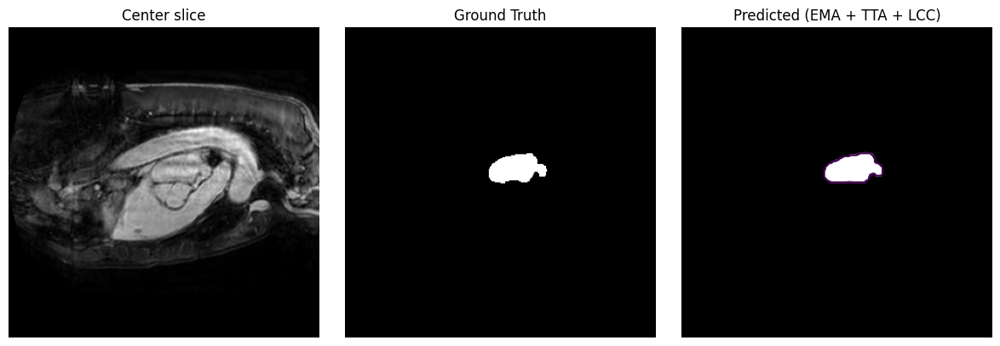

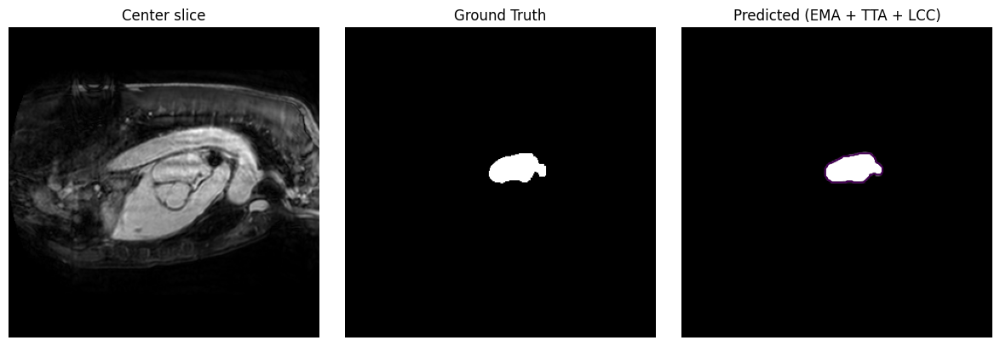

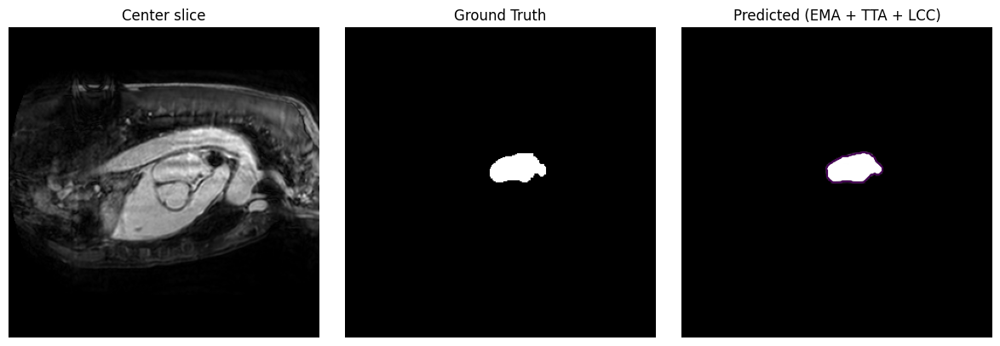

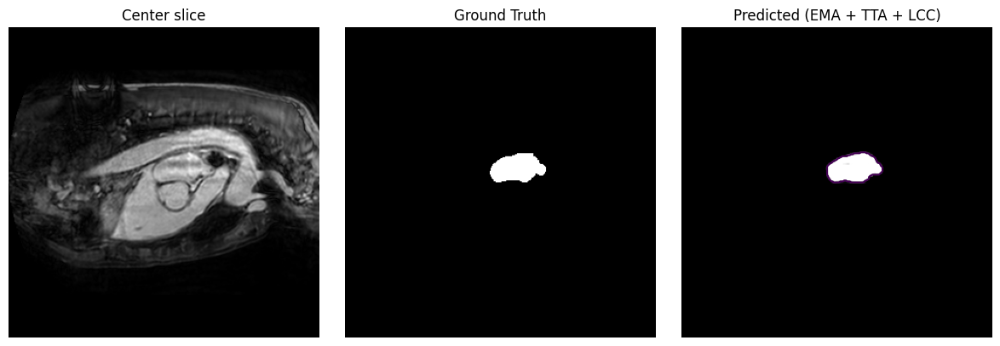

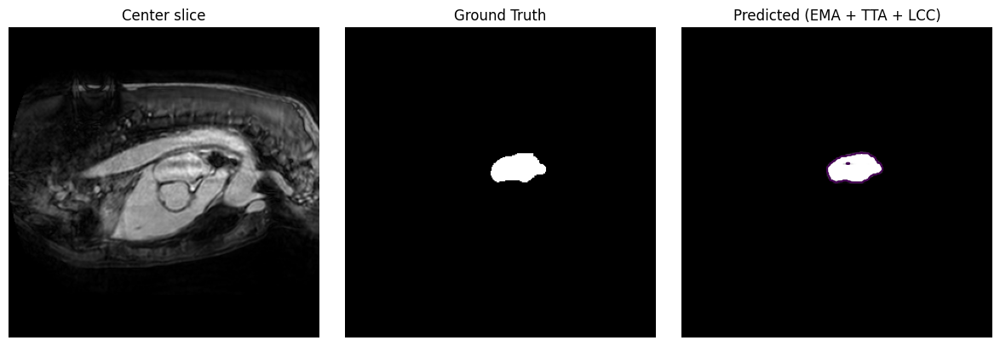

In [ ]:
# ===== Phase 8: Evaluation & viz (EMA + TTA + LCC) =====

# Load best and optionally apply EMA weights for eval
ckpt = torch.load('/content/best_mri_seg_ft.pt', map_location=device)
net.load_state_dict(ckpt['model'], strict=False)
backbone.load_state_dict(ckpt['backbone'], strict=False)

# Build EMA objects and load shadows (so we can apply them)
ema_net_eval = EMA(net, decay=0.0)         # decay unused here
ema_bkb_eval = EMA(backbone, decay=0.0)
if 'ema_net' in ckpt:       # load EMA shadows if present
    for n, p in net.named_parameters():
        if n in ckpt['ema_net']: ema_net_eval.shadow[n] = ckpt['ema_net'][n].to(device)
if 'ema_backbone' in ckpt:
    for n, p in backbone.named_parameters():
        if n in ckpt['ema_backbone']: ema_bkb_eval.shadow[n] = ckpt['ema_backbone'][n].to(device)

# Apply EMA for evaluation (recommended)
ema_net_eval.apply_to(net)
ema_bkb_eval.apply_to(backbone)

with torch.no_grad():
    print("Val (EMA, TTA+LCC):", dice_metrics(net, val_dataset,  device=device, batch_size=12, thr=0.5, use_tta=True, use_lcc=True))
    print("Test(EMA, TTA+LCC):", dice_metrics(net, test_dataset, device=device, batch_size=12, thr=0.5, use_tta=True, use_lcc=True))

# Visualization (EMA params are already applied)
import matplotlib.pyplot as plt
net.eval(); backbone.eval()
N = 200; thr = 0.5; use_tta = True; use_lcc = True

with torch.inference_mode():
    shown = 0
    for i in range(len(test_dataset)):
        img, lb = test_dataset[i]                             # (3,H,W), (H,W)
        img = img.unsqueeze(0).to(device).float()             # (1,3,H,W)
        lb  = lb.unsqueeze(0).unsqueeze(1).to(device).float() # (1,1,H,W)

        logits = tta_logits(net, img, device) if use_tta else net(*preprocess_torch(img, device))
        probs  = torch.sigmoid(logits)
        if probs.shape[-2:] != lb.shape[-2:]:
            probs = F.interpolate(probs, size=lb.shape[-2:], mode='bilinear', align_corners=False)

        pred_mask = (probs > thr).float()
        if use_lcc: pred_mask = keep_largest_cc_batch(pred_mask)

        img_cpu = img[0, 1].detach().cpu().numpy()  # center channel of 2.5D
        gt_cpu  = lb[0, 0].detach().cpu().numpy()
        pr_cpu  = probs[0, 0].detach().cpu().numpy()
        pm_cpu  = pred_mask[0, 0].detach().cpu().numpy()

        plt.figure(figsize=(12,4))
        plt.subplot(1,3,1); plt.imshow(img_cpu, cmap='gray'); plt.title('Center slice'); plt.axis('off')
        plt.subplot(1,3,2); plt.imshow(gt_cpu,  cmap='gray'); plt.title('Ground Truth'); plt.axis('off')
        ax = plt.subplot(1,3,3)
        ax.imshow(pr_cpu, cmap='gray', vmin=0, vmax=1, interpolation='nearest')
        ax.contour(pm_cpu, levels=[0.5], linewidths=1.5)
        ax.set_title('Predicted (EMA + TTA + LCC)'); ax.axis('off')
        plt.tight_layout(); plt.show(); plt.close()

        shown += 1
        if shown >= N: break

# to train further...
ema_net_eval.restore(net)
ema_bkb_eval.restore(backbone)


In [ ]:
enc_params = sum(p.numel() for p in backbone.parameters())
dec_params = sum(p.numel() for p in net.parameters())
print(f"Encoder params: {enc_params/1e6:.1f}M")
print(f"Decoder params: {dec_params/1e6:.1f}M")

Encoder params: 195.2M
Decoder params: 78.3M
